In [4]:
#import full table as df
import pandas as pd
df = pd.read_table(r"C:\Users\Administrator\Desktop\Yuliya_test_data_table\Yuliya_test_data_table_deconv-only.txt", delimiter = '\t')#, nrows=2)

In [89]:
print(df.head())

                       IB     plate well   C13  CD23  D13   R13   R23
0  CCGGGCTGTACGCGTACGAACC  plate001  A02  1453  1933  910  1006  1346
1  CGCTAATAACCCACTGTGCGAA  plate001  A02   849  1273  787   687   879
2  ATCAGAATCGGGCGCAGCCCTT  plate001  A04  1424  1026  430   810   632
3  CGTGGCGCACGCCGCTTCAGGA  plate001  A05   802  1180  814  1498   598
4  CGGTGTGTGTTCGGTTCTTGAA  plate001  A06   401   753  225   365   293


In [5]:
dfclean2 = df.copy()
dfclean2 = dfclean2[~dfclean2.index.isin(range(33482, 33797))] #122
dfclean2 = dfclean2[~dfclean2.index.isin(range(34747, 35652))] #126, 127, 128
dfclean2 = dfclean2[~dfclean2.index.isin(range(35930, 36501))] #130, 131
dfclean2 = dfclean2[~dfclean2.index.isin(range(36770, 37054))] #133
dfclean2 = dfclean2[~dfclean2.index.isin(range(38773, 39015))] #140
dfclean2 = dfclean2[~dfclean2.index.isin(range(39325, 39543))] #142
dfclean2 = dfclean2[~dfclean2.index.isin(range(40030, 46853))] #145, 146
dfclean2 = dfclean2[~dfclean2.index.isin(range(46853, 49718))] #170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182
dfclean2 = dfclean2[~(dfclean2.index >= 115849)] #the rest
print(dfclean2)

                            IB     plate well   C15   C25   D15   D25   R15  \
0       AGTTAACTAAGTACGGGATTGG  plate001  A02  1739  1521  1682  1733   641   
1       ACTTAGGTGCTGTTACGGCTAG  plate001  A04  3131  1540  1622  2899   857   
2       CGATTTGGGTTTTATCATCCCG  plate001  A04  1635   670  1439  3013   787   
3       CGTACCAGGAAGTCAGAGTCCG  plate001  A04  2993  1581  1011  2151   738   
4       GACCTACGAGGTACTGGTGAGG  plate001  A05  1893  2035  1413  3112  1126   
...                        ...       ...  ...   ...   ...   ...   ...   ...   
115844  CAGGGGCGTGTTAGTTTCGCGG  plate422  P19   693   356   677  1761   244   
115845  TCGCACGATGCTAGACTATACC  plate422  P21  1109  1053  1107  2016   447   
115846  GCACGAGTTTACGTTACTTTGG  plate422  P22     0     0     0     0     0   
115847  CAGTGGCAATGTATACCTAATT  plate422  P23   625   373   479   274    66   
115848  CAAGGTTGGGGTGTTTACTGCT  plate422  P24   283   502   405   588   163   

         R25  
0       1572  
1       1647  
2     

## SORT BY PLATE 

In [91]:
#make sure it's sorted by plate (it is but anyway)
dfs = dfclean2.groupby(df.plate)


## Summarized data

In [92]:
#summarize per plate
summary_df = pd.DataFrame(columns=['plate', 'C13', 'CD23', 'D13', 'R13', 'R23']) #D25
for plate, group in dfs:
    sums = group[['C13', 'CD23', 'D13', 'R13', 'R23']].sum()
    row = {'plate': plate, 'C13': sums['C13'], 'CD23': sums['CD23'], 'D13': sums['D13'], 'R13': sums['R13'], 'R23': sums['R23']} #'D25': sums['D25'],
    summary_df = pd.concat([summary_df, pd.DataFrame([row])], ignore_index=True)

# Print the summary dataframe
print(summary_df)

        plate     C13    CD23     D13     R13     R23
0    plate001  169776  271823  149566  184618  130273
1    plate002  173767  278030  150996  188825  135632
2    plate003  154141  249106  137583  164617  120342
3    plate004  169472  275361  148922  185778  136725
4    plate005  127605  210668  116945  142904  104639
5    plate006  153155  260899  142052  172602  124127
6    plate007  157183  257090  134981  171818  125716
7    plate008  179791  281616  152216  189711  133418
8    plate009  188561  313349  166918  210046  154574
9    plate010  229481  385102  197927  251289  189569
10   plate011   90960  148529   88239   94961   70047
11   plate012   96889  158505   90401  103002   74867
12   plate013  153904  251080  145686  141983  112555
13   plate014  140137  237356  133182  135373  100816
14   plate015  153148  260316  148311  155313  116801
15   plate016  137947  241258  137414  137746  107177
16   plate017  109663  181165   96258  121393   84645
17   plate018  176966  29405

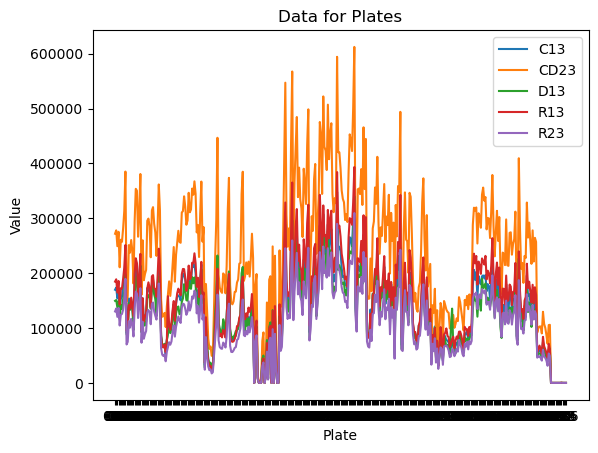

In [94]:
#one big plot
import matplotlib.pyplot as plt

# Remove the "astype(int)" function call
summary_df['plates'] = summary_df['plate'].str.extract('([0-9]+)')

plates = summary_df['plates']
c13 = summary_df['C13']
cd23 = summary_df['CD23']
d13 = summary_df['D13']
#d23 = summary_df['D25']
r13 = summary_df['R13']
r23 = summary_df['R23']

# Create the plot
fig, ax = plt.subplots()
ax.plot(plates, c13, label='C13')
ax.plot(plates, cd23, label='CD23')
ax.plot(plates, d13, label='D13')
#ax.plot(plates, d25, label='D25')
ax.plot(plates, r13, label='R13')
ax.plot(plates, r23, label='R23')

# Set the title and axis labels
ax.set_title('Data for Plates')
ax.set_xlabel('Plate')
ax.set_ylabel('Value')

# Add a legend to the plot
ax.legend()

# Show the plot
plt.show()

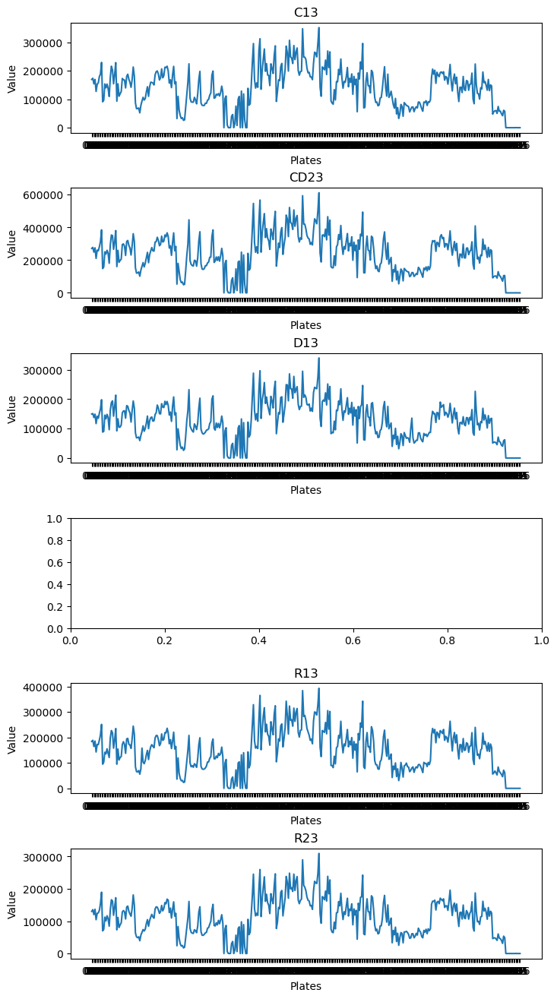

In [96]:
#seperate little plots
import matplotlib.pyplot as plt

# Remove the "astype(int)" function call
summary_df['plates'] = summary_df['plate'].str.extract('(\d+)')

plates = summary_df['plates']
c13 = summary_df['C13']
cd23 = summary_df['CD23']
d13 = summary_df['D13']
#d25 = summary_df['D25']
r13 = summary_df['R13']
r23 = summary_df['R23']

# Create a separate plot for each column
fig, axs = plt.subplots(6, 1, figsize=(8, 16))

# Plot C15
axs[0].plot(plates, c13)
axs[0].set_title('C13')
axs[0].set_xlabel('Plates')
axs[0].set_ylabel('Value')

# Plot C25
axs[1].plot(plates, cd23)
axs[1].set_title('CD23')
axs[1].set_xlabel('Plates')
axs[1].set_ylabel('Value')

# Plot D15
axs[2].plot(plates, d13)
axs[2].set_title('D13')
axs[2].set_xlabel('Plates')
axs[2].set_ylabel('Value')

# Plot D25
#axs[3].plot(plates, d25)
#axs[3].set_title('D25')
#axs[3].set_xlabel('Plates')
#axs[3].set_ylabel('Value')

# Plot R15
axs[4].plot(plates, r13)
axs[4].set_title('R13')
axs[4].set_xlabel('Plates')
axs[4].set_ylabel('Value')

# Plot R25
axs[5].plot(plates, r23)
axs[5].set_title('R23')
axs[5].set_xlabel('Plates')
axs[5].set_ylabel('Value')

# Adjust spacing between subplots
plt.subplots_adjust(hspace=0.5)

# Show the plots
plt.show()

## list plates with all zeros

In [ ]:
#list plates with all zeros
plates_with_all_zeros = []
for index, row in summary_df.iterrows():
    if (row['D15'] == 0) and (row['D25'] == 0) and (row['R15'] == 0) and (row['R25'] == 0) and (row['C15'] == 0) and (row['C25'] == 0):
        plates_with_all_zeros.append(row['plate'])
        
#print(plates_with_all_zeros)

In [41]:
# define the starting point as 'plate423'
start = 423

# create a set of all possible plate numbers after 'plate423'
all_plates = set(f'plate{i}' for i in range(start + 1, 725))

# create a set of the plates already in 'plates_with_all_zeros'
existing_plates = set(plates_with_all_zeros)

# combine the sets, removing duplicates
new_plates = list(existing_plates | all_plates)

# sort the list alphabetically
new_plates.sort()

# update 'plates_with_all_zeros' with the new plates
plates_with_all_zeros.extend(new_plates)

print(plates_with_all_zeros)

['plate122', 'plate127', 'plate133', 'plate140', 'plate146', 'plate171', 'plate173', 'plate177', 'plate180', 'plate181', 'plate182', 'plate423', 'plate424', 'plate426', 'plate428', 'plate430', 'plate433', 'plate434', 'plate435', 'plate437', 'plate438', 'plate439', 'plate440', 'plate441', 'plate442', 'plate444', 'plate445', 'plate447', 'plate449', 'plate450', 'plate452', 'plate453', 'plate454', 'plate455', 'plate465', 'plate466', 'plate467', 'plate469', 'plate471', 'plate472', 'plate474', 'plate482', 'plate483', 'plate484', 'plate485', 'plate487', 'plate488', 'plate489', 'plate490', 'plate491', 'plate494', 'plate497', 'plate499', 'plate500', 'plate501', 'plate502', 'plate505', 'plate509', 'plate511', 'plate512', 'plate514', 'plate515', 'plate516', 'plate517', 'plate518', 'plate519', 'plate520', 'plate521', 'plate522', 'plate523', 'plate524', 'plate526', 'plate527', 'plate529', 'plate530', 'plate531', 'plate532', 'plate533', 'plate534', 'plate537', 'plate539', 'plate540', 'plate541', 'pl

## clean data

In [54]:
#dfclean = df[~df['plate'].isin(plates_with_all_zeros)] 
#print(dfclean)
# this is not working for whatever reason - missing a couple plates, probably ones w/ false positives

In [64]:
dfclean2 = df.copy()
dfclean2 = dfclean2[~dfclean2.index.isin(range(33482, 33797))] #122
dfclean2 = dfclean2[~dfclean2.index.isin(range(34747, 35652))] #126, 127, 128
dfclean2 = dfclean2[~dfclean2.index.isin(range(35930, 36501))] #130, 131
dfclean2 = dfclean2[~dfclean2.index.isin(range(36770, 37054))] #133
dfclean2 = dfclean2[~dfclean2.index.isin(range(38773, 39015))] #140
dfclean2 = dfclean2[~dfclean2.index.isin(range(39325, 39543))] #142
dfclean2 = dfclean2[~dfclean2.index.isin(range(40030, 46853))] #145, 146
dfclean2 = dfclean2[~dfclean2.index.isin(range(46853, 49718))] #170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182
dfclean2 = dfclean2[~(dfclean2.index >= 115849)] #the rest
print(dfclean2)


                             IB     plate well     C15    C25     D15    D25  \
0        AGTTAACTAAGTACGGGATTGG  plate001  A02    1739   1521    1682   1733   
1        ACTTAGGTGCTGTTACGGCTAG  plate001  A04    3131   1540    1622   2899   
2        CGATTTGGGTTTTATCATCCCG  plate001  A04    1635    670    1439   3013   
3        CGTACCAGGAAGTCAGAGTCCG  plate001  A04    2993   1581    1011   2151   
4        GACCTACGAGGTACTGGTGAGG  plate001  A05    1893   2035    1413   3112   
5        CGTTGGCGCAGGTAGTCTGACT  plate001  A08     562    349    1150   4237   
6        CAAATCTTTGCTAGTTCACCGG  plate001  A12      20     30       6     37   
7        AGATGCGAGTGTATACCGTTAG  plate001  A13    1063    839     419   1173   
8        CACCGCGGCGCTGGTGTACGAG  plate001  A14    3086   2040    1963   4495   
9        GCTTTTCTTTATTGGGTTAACA  plate001  A15    2122   2035    3278   4272   
10       ATAATTCCAGATTAGGCTTATT  plate001  A16      25     42       0     66   
11       AGGGTTATTTTGGTACATATGG  plate00

## break up into single dataframes

In [ ]:
#break up dfs into a datafile for each plate
for i in range(1, 724):
    num_str = str(i).zfill(3)
    plate_num = 'plate' + num_str
    globals()['df' + num_str] = dfs.get_group(plate_num)
    print(globals()['df' + num_str])
#print(df070)

## clean summary - drop empty plates

In [56]:
summary_df2 = pd.DataFrame(columns=['plate', 'C15', 'C25', 'D15', 'D25', 'R15', 'R25'])
for plate, group in dfclean.groupby('plate'):
    sums = group[['C15', 'C25', 'D15', 'D25', 'R15', 'R25']].sum()
    row = {'plate': plate, 'C15': sums['C15'], 'C25': sums['C25'], 'D15': sums['D15'], 'D25': sums['D25'], 'R15': sums['R15'], 'R25': sums['R25']}
    summary_df2 = pd.concat([summary_df2, pd.DataFrame([row])], ignore_index=True)
summary_df2 = summary_df2.drop(index=range(418, len(summary_df2)))
# Print the summary dataframe
display(summary_df2)

,plate,C15,C25,D15,D25,R15,R25
0,-,5461180,4942203,4542793,8594170,2147000,4710001
1,plate001,379709,349954,285455,536222,160881,335094
2,plate002,358144,326336,266774,497456,146570,303694
3,plate003,358808,327455,270007,482716,145853,305168
4,plate004,448901,397904,320434,610421,183086,382947
5,plate005,318971,294435,246999,465688,134811,290901
6,plate006,335914,314263,273927,478121,140203,294445
7,plate007,374718,338392,284449,524338,149185,325796
8,plate008,420367,390527,304760,570713,171603,355351
9,plate009,402231,383094,325312,593348,164619,358986


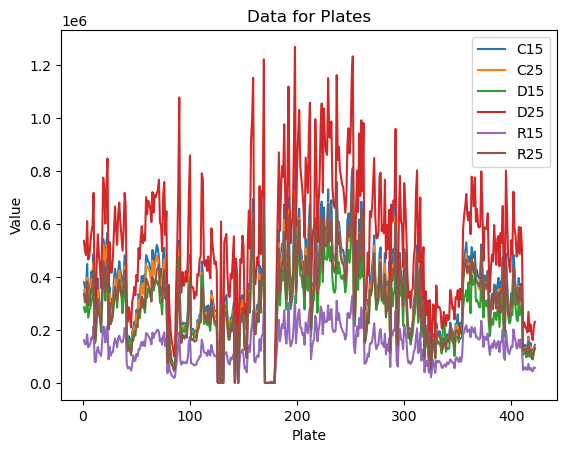

In [58]:
#one big plot
import matplotlib.pyplot as plt

# Remove the "astype(int)" function call
summary_df2['plates'] = summary_df2['plate'].str.extract('(\d+)')

plates = summary_df2['plates']
c15 = summary_df2['C15']
c25 = summary_df2['C25']
d15 = summary_df2['D15']
d25 = summary_df2['D25']
r15 = summary_df2['R15']
r25 = summary_df2['R25']

# Create the plot
fig, ax = plt.subplots()
ax.plot(plates, c15, label='C15')
ax.plot(plates, c25, label='C25')
ax.plot(plates, d15, label='D15')
ax.plot(plates, d25, label='D25')
ax.plot(plates, r15, label='R15')
ax.plot(plates, r25, label='R25')

# Set the title and axis labels
ax.set_title('Data for Plates')
ax.set_xlabel('Plate')
ax.set_ylabel('Value')

# Add a legend to the plot
ax.legend()

# Show the plot
plt.show()

In [28]:
#seperate little plots
import matplotlib.pyplot as plt
import numpy as np

# Remove the "astype(int)" function call
summary_df2['plates'] = summary_df2['plate'].str.extract('(\d+)')


plates = summary_df2['plates']
c15 = summary_df2['C15']
c25 = summary_df2['C25']
d15 = summary_df2['D15']
d25 = summary_df2['D25']
r15 = summary_df2['R15']
r25 = summary_df2['R25']

# Create a separate plot for each column
fig, axs = plt.subplots(6, 1, figsize=(200, 160))
# Drop values on the y-axis between 0 and 50
summary_df2['C15'] = np.where((summary_df2['C15'] > 500) & (summary_df2['C15'] < 99999), summary_df2['C15'], np.nan)
summary_df2['C25'] = np.where((summary_df2['C25'] > 500) & (summary_df2['C25'] < 99999), summary_df2['C25'], np.nan)
summary_df2['D15'] = np.where((summary_df2['D15'] > 500) & (summary_df2['D15'] < 99999), summary_df2['D15'], np.nan)
summary_df2['D25'] = np.where((summary_df2['D25'] > 500) & (summary_df2['D25'] < 99999), summary_df2['D25'], np.nan)
summary_df2['R15'] = np.where((summary_df2['R15'] > 500) & (summary_df2['R15'] < 99999), summary_df2['R15'], np.nan)
summary_df2['R25'] = np.where((summary_df2['R25'] > 500) & (summary_df2['R25'] < 99999), summary_df2['R25'], np.nan)

# Plot C15
axs[0].plot(plates, c15)
axs[0].set_title('C15')
axs[0].set_xlabel('Plates')
axs[0].set_ylabel('Value')

# Plot C25
axs[1].plot(plates, c25)
axs[1].set_title('C25')
axs[1].set_xlabel('Plates')
axs[1].set_ylabel('Value')

# Plot D15
axs[2].plot(plates, d15)
axs[2].set_title('D15')
axs[2].set_xlabel('Plates')
axs[2].set_ylabel('Value')

# Plot D25
axs[3].plot(plates, d25)
axs[3].set_title('D25')
axs[3].set_xlabel('Plates')
axs[3].set_ylabel('Value')

# Plot R15
axs[4].plot(plates, r15)
axs[4].set_title('R15')
axs[4].set_xlabel('Plates')
axs[4].set_ylabel('Value')

# Plot R25
axs[5].plot(plates, r25)
axs[5].set_title('R25')
axs[5].set_xlabel('Plates')
axs[5].set_ylabel('Value')

# Adjust spacing between subplots
plt.subplots_adjust(hspace=0.5)

# Show the plots
plt.show()


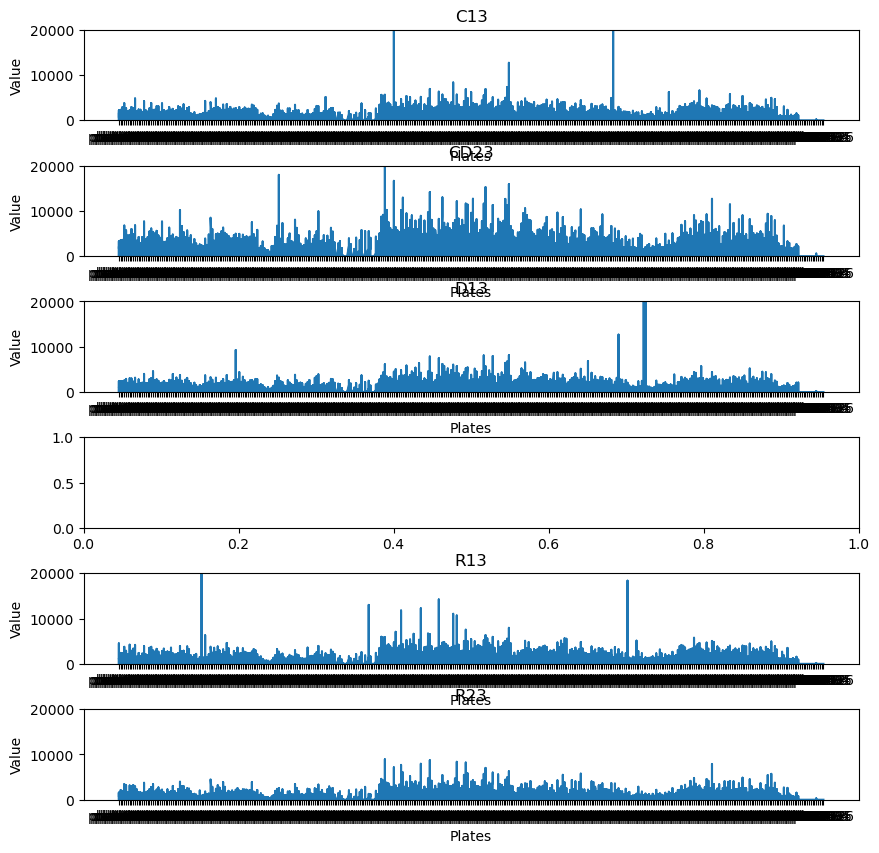

In [101]:


import matplotlib.pyplot as plt

plates = dfclean2['plate']
c13 = dfclean2['C13']
cd23 = dfclean2['CD23']
d13 = dfclean2['D13']
#d25 = dfclean2['D23']
r13 = dfclean2['R13']
r23 = dfclean2['R23']

# Create a separate plot for each column
fig, axs = plt.subplots(6, 1, figsize=(10, 10))

# Plot C15
axs[0].plot(plates, c13)
axs[0].set_title('C13')
axs[0].set_xlabel('Plates')
axs[0].set_ylabel('Value')
axs[0].set_ylim(0, 20000)

# Plot C25
axs[1].plot(plates, cd23)
axs[1].set_title('CD23')
axs[1].set_xlabel('Plates')
axs[1].set_ylabel('Value')
axs[1].set_ylim(0, 20000)

# Plot D15
axs[2].plot(plates, d13)
axs[2].set_title('D13')
axs[2].set_xlabel('Plates')
axs[2].set_ylabel('Value')
axs[2].set_ylim(0, 20000)

# Plot D25
#axs[3].plot(plates, d25)
#axs[3].set_title('D25')
#axs[3].set_xlabel('Plates')
#axs[3].set_ylabel('Value')
#axs[3].set_ylim(0, 20000)

# Plot R15
axs[4].plot(plates, r13)
axs[4].set_title('R13')
axs[4].set_xlabel('Plates')
axs[4].set_ylabel('Value')
axs[4].set_ylim(0, 20000)

# Plot R25
axs[5].plot(plates, r23)
axs[5].set_title('R23')
axs[5].set_xlabel('Plates')
axs[5].set_ylabel('Value')
axs[5].set_ylim(0, 20000)

# Adjust spacing between subplots
plt.subplots_adjust(hspace=0.5)


# Show the plots
plt.show()


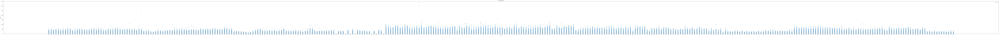

In [8]:
import matplotlib.pyplot as plt

dfclean2 = dfclean2.dropna(subset=['plate'])
dfclean2['plates'] = dfclean2['plate'].str.extract('(\d+)')

plates = dfclean2['plates']
c15 = dfclean2['C15']
c25 = dfclean2['C25']
d15 = dfclean2['D15']
d25 = dfclean2['D25']
r15 = dfclean2['R15']
r25 = dfclean2['R25']

fig, ax = plt.subplots(figsize=(300, 10))
ax.plot(plates, c15, label='C15', linestyle='None', marker='o')
#ax.plot(plates, c25, label='C25', linestyle='None', marker='o')
#ax.plot(plates, d15, label='D15', linestyle='None', marker='o')
#ax.plot(plates, d25, label='D25', linestyle='None', marker='o')
#ax.plot(plates, r15, label='R15', linestyle='None', marker='o')
#ax.plot(plates, r25, label='R25', linestyle='None', marker='o')

ax.set_title('Data for Plates')
ax.set_xlabel('Plate')
ax.set_ylabel('Value')
ax.set_ylim(0, 35000)

ax.legend()

plt.show()

In [32]:
print(dfclean2.head())


                       IB     plate well   C15   C25   D15   D25   R15   R25  \
0  AGTTAACTAAGTACGGGATTGG  plate001  A02  1739  1521  1682  1733   641  1572   
1  ACTTAGGTGCTGTTACGGCTAG  plate001  A04  3131  1540  1622  2899   857  1647   
2  CGATTTGGGTTTTATCATCCCG  plate001  A04  1635   670  1439  3013   787  1455   
3  CGTACCAGGAAGTCAGAGTCCG  plate001  A04  2993  1581  1011  2151   738  1546   
4  GACCTACGAGGTACTGGTGAGG  plate001  A05  1893  2035  1413  3112  1126  1779   

  plates  
0    001  
1    001  
2    001  
3    001  
4    001  


## Analyze missing wells

In [ ]:
# filter the dataframe for rows where any column has a zero value
df_filtered = df[(df==0).any(axis=1)]

# print the filtered dataframe
print(df_filtered)

In [ ]:
#dfnew = df[df['plate'].isin(plates_with_all_zeros)] 

In [ ]:
#import pandas as pd

# Set the chunk size
#chunk_size = 500

# Initialize the new DataFrame
#df_new = pd.DataFrame()

# Group the DataFrame into chunks of size `chunk_size`
#groups = df.groupby(df.index // chunk_size)

# Iterate over the groups and append filtered rows to df_new
#for group_name, group_data in groups:
#    mask = (group_data[['C15', 'C25', 'D15', 'D25', 'R15', 'R25']] < 100).any(axis=1)
#    df_new = pd.concat([df_new, group_data[mask]])

# Print the new DataFrame
#print(df_new)

In [ ]:
#import psutil
#process = psutil.Process()
#print(process.memory_info().rss / 1024**2) # memory usage in MB